In [1]:
import os
#virtually move to parent directory
os.chdir("CLIP-dissect")

import torch

import matplotlib
from matplotlib import pyplot as plt

import utils
import data_utils
import similarity
import pandas as pd

100%|██████████| 2048/2048 [00:42<00:00, 47.75it/s]


torch.Size([2048, 1197])


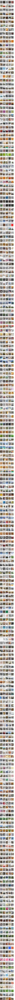

In [4]:
figure = 'CLIP_layer3'

settings = {
            'CLIP_layer4': {"target_name":'resnet50', "target_layer": 'layer4', "neurons_to_display": "CLIP-Dissect"}
           }

target_name = settings[figure]["target_name"]
target_layer = settings[figure]["target_layer"]
neurons_to_display = settings[figure]["neurons_to_display"]

clip_name = 'ViT-B/16'
d_probe = 'broden'
concept_set = 'data/broden_labels_clean.txt'
batch_size = 200
device = 'cuda'
pool_mode = 'avg'

save_dir = 'saved_activations'
similarity_fn = similarity.soft_wpmi

utils.save_activations(clip_name = clip_name, 
                       target_name = target_name, target_layers = [target_layer], 
                       d_probe = d_probe, concept_set = concept_set, batch_size = batch_size, 
                       device = device, pool_mode=pool_mode, save_dir = save_dir)


save_names = utils.get_save_names(clip_name = clip_name, target_name = target_name,
                                  target_layer = target_layer, d_probe = d_probe,
                                  concept_set = concept_set, pool_mode=pool_mode,
                                  save_dir = save_dir)

target_save_name, clip_save_name, text_save_name = save_names

similarities, target_feats = utils.get_similarity_from_activations(target_save_name, clip_save_name, 
                                                             text_save_name, similarity_fn, device=device)

with open(concept_set, 'r') as f: 
    words = (f.read()).split('\n')

pil_data = data_utils.get_data(d_probe)

top_vals, top_ids = torch.topk(target_feats, k=5, dim=0)

name_conversion = {'resnet50':'resnet50_imagenet', 'resnet18_places':'resnet18_places365'}
ood_names = {'resnet50':'p', 'resnet18_places': 'i'}

# Load Network Dissection results
netdissect_res = pd.read_csv('data/NetDissect_results/{}_{}.csv'.format(name_conversion[target_name],
                                                                       target_layer))
nd_ious = netdissect_res['score'].values
nd_labels = netdissect_res['label'].values

#Load MILAN results
milan_base = pd.read_csv('data/MILAN_results/m_base_{}.csv'.format(name_conversion[target_name]))
if target_name == 'resnet50':
    milan_ood = pd.read_csv('data/MILAN_results/m_places365_{}.csv'.format(name_conversion[target_name]))
elif target_name == 'resnet18_places':
    milan_ood = pd.read_csv('data/MILAN_results/m_imagenet_{}.csv'.format(name_conversion[target_name]))
    
milan_base = milan_base[milan_base['layer']==target_layer]
milan_base = milan_base.sort_values(by=['unit'])
milan_base = list(milan_base['description'])

milan_ood = milan_ood[milan_ood['layer']==target_layer]
milan_ood = milan_ood.sort_values(by=['unit'])
milan_ood = list(milan_ood['description'])

# Calculate which neurons to show
if type(neurons_to_display)==list:
    ids_to_check = neurons_to_display
if neurons_to_display == "CLIP-Dissect":
    ids_to_check = torch.sort(torch.max(similarities, dim=1)[0], descending=True)[1][0:100]
elif neurons_to_display == "NetDissect":
    ids_to_check = torch.sort(torch.tensor(nd_ious), descending=True)[1][0:100]

    
#plot figures
font_size=14
font = {'size'   : font_size}

matplotlib.rc('font', **font)

fig = plt.figure(figsize=[10, len(ids_to_check)*2.2])
subfigs = fig.subfigures(nrows=len(ids_to_check), ncols=1)
for j, orig_id in enumerate(ids_to_check):
    vals, ids = torch.topk(similarities[orig_id], k=5, largest=True)
        
    subfig = subfigs[j]
    subfig.text(0.13, 0.96, "Neuron {}:".format(int(orig_id)), size=font_size)
    subfig.text(0.27, 0.96, "CLIP-Dissect:", size=font_size)
    subfig.text(0.4, 0.96, words[int(ids[0])], size=font_size)
    subfig.text(0.53 ,0.96, "NetDissect:", size=font_size)
    subfig.text(0.65 ,0.96, nd_labels[orig_id], size=font_size)
    
    subfig.text(0.13, 0.85, "MILAN(b):", size=font_size)
    subfig.text(0.24, 0.85, milan_base[orig_id], size=font_size)
    
    subfig.text(0.53, 0.85, "MILAN({}):".format(ood_names[target_name]), size=font_size)
    subfig.text(0.63, 0.85, milan_ood[orig_id], size=font_size)
    axs = subfig.subplots(nrows=1, ncols=5)
    for i, top_id in enumerate(top_ids[:, orig_id]):
        im, label = pil_data[top_id]
        im = im.resize([375,375])
        axs[i].imshow(im)
        axs[i].axis('off')
plt.show()

In [5]:
neuron_data = []

# Iterate through neurons and gather data
for j, orig_id in enumerate(ids_to_check):
    vals, ids = torch.topk(similarities[orig_id], k=5, largest=True)

    # Gather information for each neuron
    neuron_info = {
        'Neuron_Number': int(orig_id),
        'CLIP-Dissect': words[int(ids[0])],
        'NetDissect': nd_labels[orig_id],
        'MILAN(b)': milan_base[orig_id],
        'MILAN({})'.format(ood_names[target_name]): milan_ood[orig_id]
    }

    neuron_data.append(neuron_info)

# Create a DataFrame
df = pd.DataFrame(neuron_data)

# Save DataFrame to Excel with encoding specified when reading the CSV
excel_file_path = 'neuron_data_layer4_label.xlsx'
df.to_excel(excel_file_path, index=False, engine='openpyxl')

print(f'Data saved to {excel_file_path}')

Data saved to neuron_data_layer4_label.xlsx


In [21]:
file_path1 = 'neuron_data_layer1_labeled.xlsx'
file_path2 = 'neuron_data_layer2_labeled.xlsx'
file_path3 = 'neuron_data_layer3_labeled.xlsx'
file_path4 = 'neuron_data_layer4_labeled.xlsx'

# Read the Excel file into a DataFrame
df_layer1 = pd.read_excel(file_path1)
df_layer2 = pd.read_excel(file_path2)
df_layer3 = pd.read_excel(file_path3)
df_layer4 = pd.read_excel(file_path4)

df_layer1 = df_layer1[df_layer1.columns[-4:]]
df_layer2 = df_layer2[df_layer2.columns[-4:]]
df_layer3 = df_layer3[df_layer3.columns[-4:]]
df_layer4 = df_layer4[df_layer4.columns[-4:]]

In [27]:
df_layer1.mean()

CLIP-Dissect_rate    4.333333
NetDissect_rate      4.161616
MILAN(b)_rate        3.818182
MILAN(p)_rate        3.363636
dtype: float64

In [29]:
df_layer2.mean()

CLIP-Dissect_rate    4.666667
NetDissect_rate      4.262626
MILAN(b)_rate        3.757576
MILAN(p)_rate        3.101010
dtype: float64

In [30]:
df_layer3.mean()

CLIP-Dissect_rate    4.818182
NetDissect_rate      4.323232
MILAN(b)_rate        3.212121
MILAN(p)_rate        2.929293
dtype: float64

In [28]:
df_layer4.mean()

CLIP-Dissect_rate    4.969697
NetDissect_rate      4.838384
MILAN(b)_rate        3.292929
MILAN(p)_rate        2.787879
dtype: float64

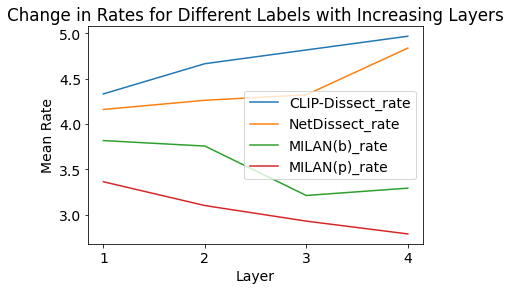

In [31]:
import matplotlib.pyplot as plt

# Assuming you have the mean values stored in variables like df_layer1_mean, df_layer2_mean, etc.

layers = [1, 2, 3, 4]

# Mean values for each label
clip_dissect_rate = [4.333333, 4.666667, 4.818182, 4.969697]
net_dissect_rate = [4.161616, 4.262626, 4.323232, 4.838384]
milan_b_rate = [3.818182, 3.757576, 3.212121, 3.292929]
milan_p_rate = [3.363636, 3.101010, 2.929293, 2.787879]

# Plotting the lines
plt.plot(layers, clip_dissect_rate, label='CLIP-Dissect_rate')
plt.plot(layers, net_dissect_rate, label='NetDissect_rate')
plt.plot(layers, milan_b_rate, label='MILAN(b)_rate')
plt.plot(layers, milan_p_rate, label='MILAN(p)_rate')

# Adding labels and title
plt.xlabel('Layer')
plt.ylabel('Mean Rate')
plt.title('Change in Rates for Different Labels with Increasing Layers')

# Adding a legend
plt.legend()

# Setting x-axis ticks
plt.xticks(layers)

# Display the plot
plt.show()


In [35]:
data = {
    "clip_dissect_rate" : [4.333333, 4.666667, 4.818182, 4.969697],
    "net_dissect_rate" : [4.161616, 4.262626, 4.323232, 4.838384],
    "milan_b_rate" : [3.818182, 3.757576, 3.212121, 3.292929],
    "milan_p_rate" : [3.363636, 3.101010, 2.929293, 2.787879]
}

layers = [1, 2, 3, 4]

df = pd.DataFrame(data, index=layers)

# Displaying the DataFrame
print(df)


   clip_dissect_rate  net_dissect_rate  milan_b_rate  milan_p_rate
1           4.333333          4.161616      3.818182      3.363636
2           4.666667          4.262626      3.757576      3.101010
3           4.818182          4.323232      3.212121      2.929293
4           4.969697          4.838384      3.292929      2.787879
